In [ ]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [ ]:
from fastai import *
from fastai.vision import *

In [ ]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [ ]:
!unzip gdrive/"My Drive"/Breakhis_res_dep_bc.zip

Streaming output truncated to the last 5000 lines.
  inflating: Breakhis_res_dep_bc/200x/train/malignant/SOB_M_DC-14-12312-200-015.png  
  inflating: Breakhis_res_dep_bc/200x/train/malignant/SOB_M_DC-14-12312-200-016.png  
  inflating: Breakhis_res_dep_bc/200x/train/malignant/SOB_M_DC-14-12312-200-017.png  
  inflating: Breakhis_res_dep_bc/200x/train/malignant/SOB_M_DC-14-12312-200-018.png  
  inflating: Breakhis_res_dep_bc/200x/train/malignant/SOB_M_DC-14-12312-200-019.png  
  inflating: Breakhis_res_dep_bc/200x/train/malignant/SOB_M_DC-14-12312-200-020.png  
  inflating: Breakhis_res_dep_bc/200x/train/malignant/SOB_M_DC-14-12312-200-021.png  
  inflating: Breakhis_res_dep_bc/200x/train/malignant/SOB_M_DC-14-12312-200-022.png  
  inflating: Breakhis_res_dep_bc/200x/train/malignant/SOB_M_DC-14-12312-200-023.png  
  inflating: Breakhis_res_dep_bc/200x/train/malignant/SOB_M_DC-14-12312-200-024.png  
  inflating: Breakhis_res_dep_bc/200x/train/malignant/SOB_M_DC-14-12312-200-025.png  
  i

In [ ]:
import os
from shutil import copyfile

In [ ]:
# Seperate 40x, 100x, 200x, 400x images into seperate directories.
# Each element of the below list is a path to the directory.
directories = ['tf_files/breast_40', 'tf_files/breast_100', 'tf_files/breast_200', 'tf_files/breast_400']

for directory in directories:
    # Make directory if it does not exist
    if not os.path.exists(directory):
        os.makedirs(directory)

    directory_b = directory+'/benign'
    directory_m = directory+'/malignant'
    # Make benign and malignant sub-directories for each directory if they do not exist
    if not os.path.exists(directory_b):
        os.makedirs(directory_b)
    if not os.path.exists(directory_m):
        os.makedirs(directory_m)

In [ ]:
benign_types = os.listdir('BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB')
# Store the types. Example: 'adenosis', 'fibroadenoma', 'phyllodes_tumor', 'tubular_adenoma'.
benign_types = [x for x in benign_types if x!= '.DS_Store']

zooms = ['40', '100', '200', '400']

# Copy files from benign to other folder
for benign_type in benign_types:
    patients = os.listdir('BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/'+benign_type)
    patients = [x for x in patients if x!= '.DS_Store']

    for patient in patients:
        for zoom in zooms:
            images = os.listdir('BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/'+benign_type+'/'+patient+'/'+zoom+'X')
            images = [x for x in images if x!= '.DS_Store']
            for image in images:
                copyfile('BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/'+benign_type+'/'+patient+'/'+zoom+'X'+'/'+image, 'tf_files/breast_'+zoom+'/benign/'+image)

In [ ]:
malignant_types = os.listdir('BreaKHis_v1/BreaKHis_v1/histology_slides/breast/malignant/SOB')
# Store the types. Example: 'ductal_carcinoma', 'lobular_carcinoma', 'mucinous_carcinoma', 'papillary_carcinoma'.
malignant_types = [x for x in malignant_types if x!= '.DS_Store']

zooms = ['40', '100', '200', '400']

# Copy files from benign to other folder
for malignant_type in malignant_types:
    patients = os.listdir('BreaKHis_v1/BreaKHis_v1/histology_slides/breast/malignant/SOB/'+malignant_type)
    patients = [x for x in patients if x!= '.DS_Store']

    for patient in patients:
        for zoom in zooms:
            images = os.listdir('BreaKHis_v1/BreaKHis_v1/histology_slides/breast/malignant/SOB/'+malignant_type+'/'+patient+'/'+zoom+'X')
            images = [x for x in images if x!= '.DS_Store']
            for image in images:
                copyfile('BreaKHis_v1/BreaKHis_v1/histology_slides/breast/malignant/SOB/'+malignant_type+'/'+patient+'/'+zoom+'X'+'/'+image, 'tf_files/breast_'+zoom+'/malignant/'+image)

In [ ]:
from fastai.vision import *
from fastai.metrics import *

import numpy as np
np.random.seed(2)

import torch
torch.cuda.manual_seed_all(2)

import matplotlib.pyplot as ply
plt.style.use('ggplot')

In [ ]:
tfms = get_transforms(do_flip=True, flip_vert=True, max_lighting=0.3, max_warp=0.3, max_rotate=20., max_zoom=0.05)
len(tfms)

2

In [ ]:
path = '/content/Breakhis_res_dep_bc/40x/train/'

In [ ]:
path_test = '/content/Breakhis_res_dep_bc/40x/test/'

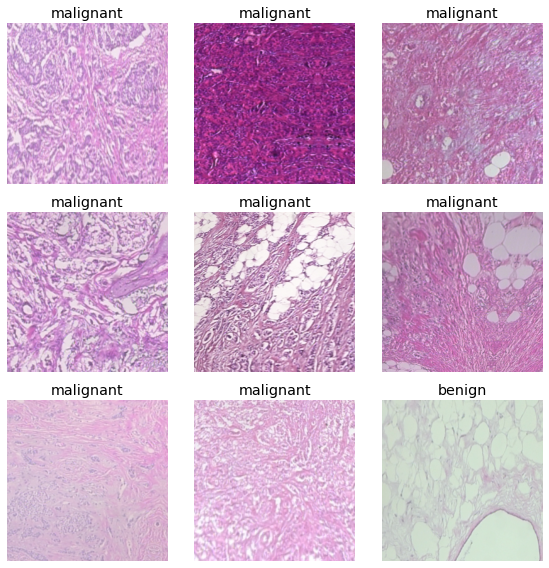

In [ ]:
data = ImageDataBunch.from_folder(path, ds_tfms=tfms, valid_pct=0.2, test = path_test, size=256, bs=64).normalize(imagenet_stats)
data.show_batch(rows=3, figsize=(8,8))

In [ ]:
data.label_list

LabelLists;

Train: LabelList (1439 items)
x: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: CategoryList
benign,benign,benign,benign,benign
Path: /content/Breakhis_res_dep_bc/40x/train;

Valid: LabelList (359 items)
x: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: CategoryList
benign,malignant,malignant,malignant,benign
Path: /content/Breakhis_res_dep_bc/40x/train;

Test: LabelList (197 items)
x: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: EmptyLabelList
,,,,
Path: /content/Breakhis_res_dep_bc/40x/train

In [ ]:
print(data.classes)
len(data.classes),data.c

['benign', 'malignant']


(2, 2)

In [ ]:
learn = cnn_learner(data, models.resnet34, metrics=(accuracy,error_rate))

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth


In [ ]:
learn.model

Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


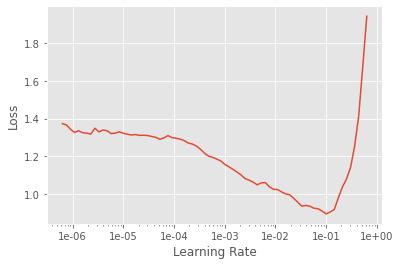

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(20)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.107922,0.398182,0.838440,0.161560,00:34
1,0.858774,0.303545,0.874652,0.125348,00:34
2,0.695878,0.200950,0.922006,0.077994,00:34
3,0.564667,0.155803,0.933148,0.066852,00:34
4,0.504960,0.138207,0.952646,0.047354,00:34
5,0.439691,0.111902,0.963788,0.036212,00:34
6,0.373905,0.116942,0.952646,0.047354,00:34
7,0.304576,0.088575,0.966574,0.033426,00:34
8,0.256304,0.096621,0.963788,0.036212,00:34
9,0.240543,0.100552,0.955432,0.044568,00:34


In [ ]:
learn.save('stage-1')

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

In [ ]:
losses
idxs

tensor([227,   9, 299, 255, 240,  85,  36, 311, 121,  17, 122, 107,   2, 317,
         76, 143, 184, 142, 302,  78, 154, 332, 286, 118, 346, 181, 226, 349,
        309, 167, 283,  24, 138, 127, 206,  46, 153, 170, 324,  66,  25, 353,
        205, 298,  23, 280, 266, 334, 158, 278,  42, 203,  77, 285, 312, 329,
        238, 216, 256, 139, 221, 290, 253, 193, 102, 351, 350, 106,  96, 111,
        178, 188, 116, 316,  86, 168,  55, 357, 261, 234,  19, 171, 136,  22,
         16, 319,   3, 172, 287, 163, 212, 162, 338, 130, 274, 284, 318, 115,
        208, 304,  79, 182, 305, 192, 323,  70, 222, 354, 199,  49, 229, 279,
        243,  28, 210,  40, 105, 151,  87, 166, 275,  97, 149, 343, 314, 282,
        326,  91, 301, 250, 292, 124,   1, 342, 104, 119, 262, 173, 209, 251,
         15,  29,  62, 358,  73,  43, 267, 214, 344,  98, 291,  61, 176, 147,
        128, 228,  44, 325,  50, 195,  54, 197, 180, 313, 131,  68, 270,  48,
         69, 244, 109, 237, 194, 245, 273, 356, 211, 190, 341, 2

In [ ]:
len(data.valid_ds)

359

In [ ]:
len(losses)

359

In [ ]:
len(idxs)

359

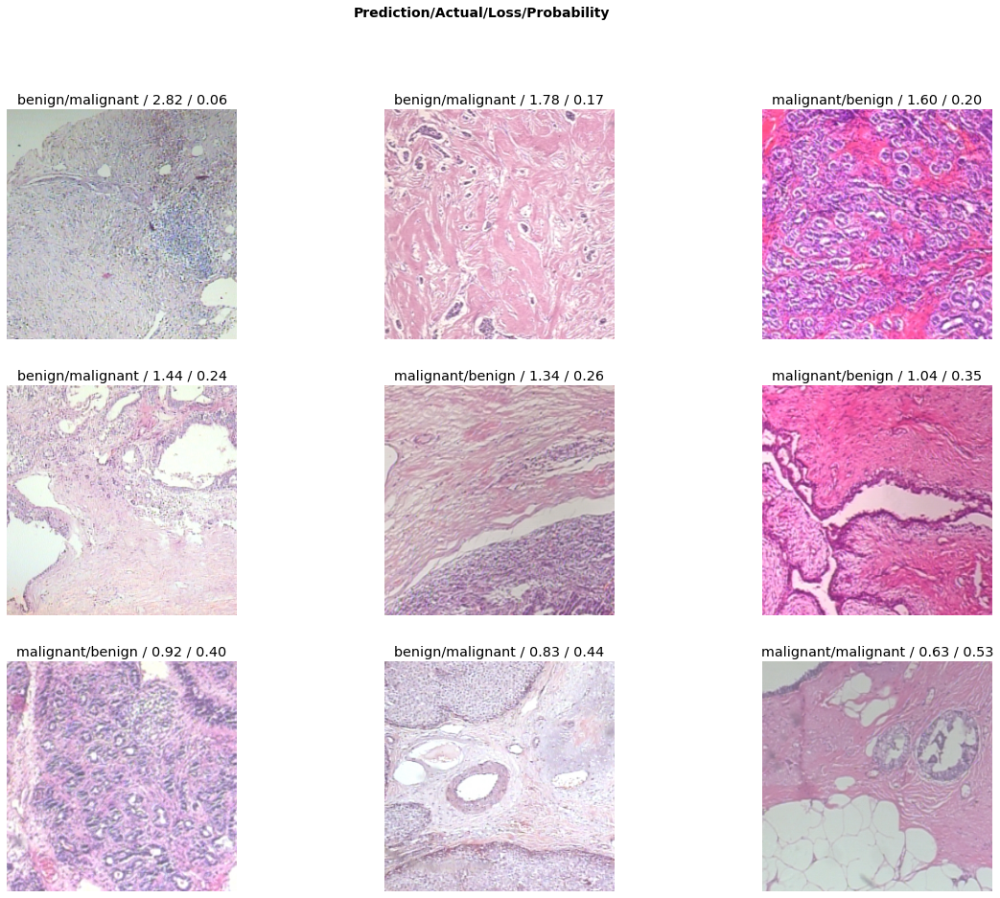

In [ ]:
interp.plot_top_losses(9, figsize=(20,15))

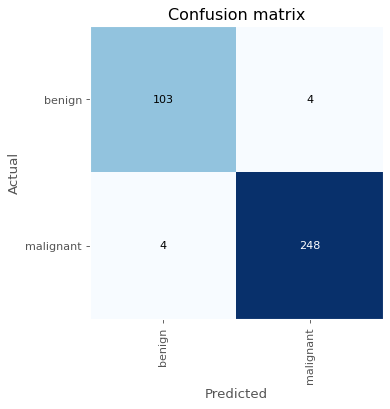

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=80)

In [ ]:
learn.unfreeze()

In [ ]:
learn.fit_one_cycle(12)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.141826,0.054840,0.977716,0.022284,00:35
1,0.128185,0.063729,0.980501,0.019499,00:35
2,0.147426,0.336522,0.902507,0.097493,00:35
3,0.156287,0.068370,0.969359,0.030641,00:35
4,0.150465,0.297128,0.924791,0.075209,00:35
5,0.130742,0.063299,0.974930,0.025070,00:35
6,0.121253,0.094777,0.969359,0.030641,00:35
7,0.105914,0.057855,0.980501,0.019499,00:35
8,0.084377,0.029892,0.988858,0.011142,00:35
9,0.067999,0.021835,0.991643,0.008357,00:35


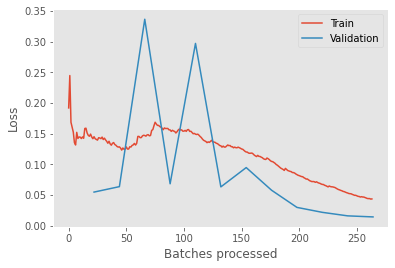

In [ ]:
learn.recorder.plot_losses()

In [ ]:
learn.lr_find()

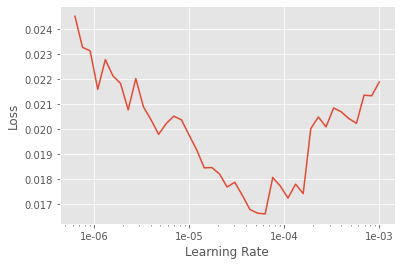

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(12,max_lr=slice(1e-05,6e-04))

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.030670,0.013174,0.994429,0.005571,00:34
1,0.023825,0.010477,0.997214,0.002786,00:34
2,0.028249,0.016794,0.991643,0.008357,00:34
3,0.029982,0.007950,0.997214,0.002786,00:34
4,0.028197,0.011103,0.997214,0.002786,00:34
5,0.025560,0.008187,0.997214,0.002786,00:34
6,0.022028,0.004794,0.997214,0.002786,00:34
7,0.021236,0.007265,0.997214,0.002786,00:34
8,0.018906,0.009342,0.997214,0.002786,00:34
9,0.017377,0.009274,0.997214,0.002786,00:34


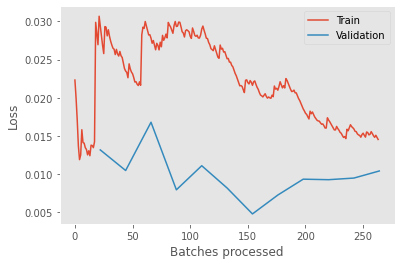

In [ ]:
learn.recorder.plot_losses()

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

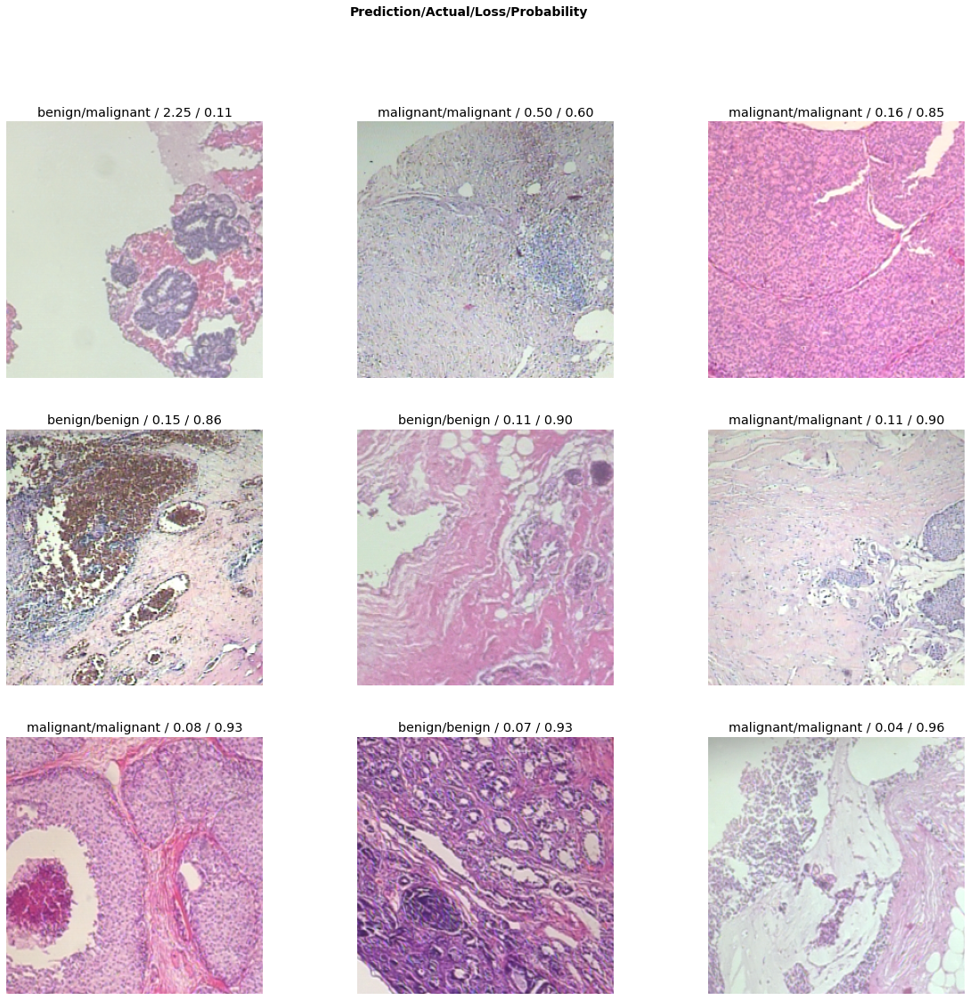

In [ ]:
interp.plot_top_losses(9, figsize=(20,18))

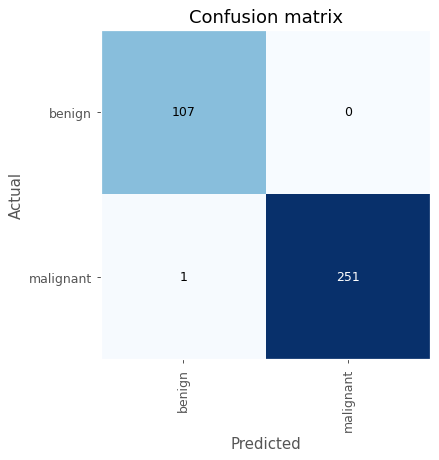

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=90)

In [ ]:
preds, y, loss = learn.get_preds(with_loss=True)
acc = accuracy(preds, y)
print('The accuracy is {0} %.'.format(acc*100))

The accuracy is 99.72145080566406 %.


In [ ]:
import sklearn.model_selection
from sklearn.metrics import roc_curve, auc

In [ ]:
# probs from log preds
probs = np.exp(preds[:,1])
# Compute ROC curve
fpr, tpr, thresholds = roc_curve(y, probs, pos_label=1)

# Compute ROC area
roc_auc = auc(fpr, tpr)
print('ROC area is {0}'.format(roc_auc))

ROC area is 0.9999629135143154


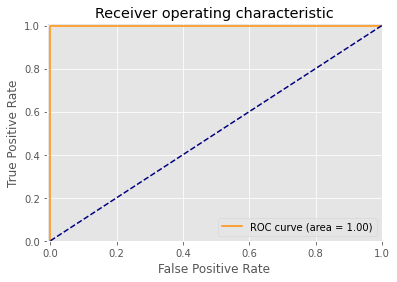

In [ ]:
plt.figure()
plt.plot(fpr, tpr, color='darkorange', label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([-0.01, 1.0])
plt.ylim([0.0, 1.01])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")

In [ ]:
preds, y, losses = learn.get_preds(DatasetType.Test, with_loss=True)
z = torch.argmax(preds, dim=1)

In [ ]:
v = []
j = []

for i in range(197):
  v.append(data.test_ds.items[i])
  j.append(z[i].cpu().numpy())

In [ ]:
import pandas as pd
a = pd.DataFrame()
a['path'] = v
a['class'] = j
A = a['path'].astype(str).str.split("/", expand = True)
a['path'] = A.iloc[:,-1]

print(a.head())

                             path class
0    SOB_B_TA-14-16184-40-021.png     0
1      SOB_B_F-14-9133-40-010.png     0
2      SOB_B_F-14-9133-40-004.png     0
3  SOB_B_PT-14-21998AB-40-003.png     0
4   SOB_B_A-14-22549CD-40-029.png     0


In [ ]:
a.to_csv('resnet34_breakhis_40x_resdep_bc.csv')

In [ ]:
from google.colab import files
files.download('resnet34_breakhis_40x_resdep_bc.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

ResNet50

In [ ]:
data = ImageDataBunch.from_folder(path, ds_tfms=tfms, valid_pct=0.2,size=256, test=path_test, bs=64).normalize(imagenet_stats)

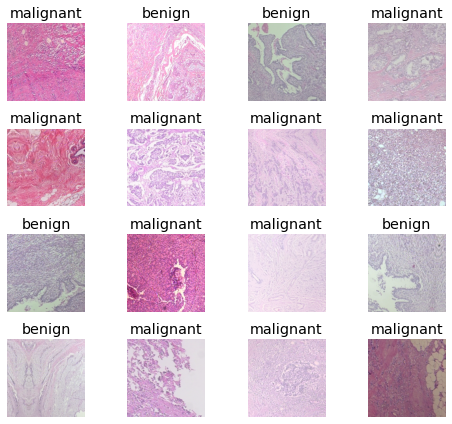

In [ ]:
data.show_batch(rows=4, figsize=(7,6))

In [ ]:
learn = cnn_learner(data, models.resnet50, metrics=(accuracy, error_rate, Precision(average='micro'), Recall(average='micro') ))

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth


In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


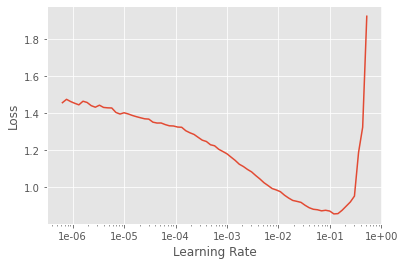

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(18)

epoch,train_loss,valid_loss,accuracy,error_rate,precision,recall,time
0,0.879054,0.357717,0.869081,0.130919,0.869081,0.869081,00:35
1,0.661259,0.373725,0.880223,0.119777,0.880223,0.880223,00:35
2,0.536908,0.227176,0.930362,0.069638,0.930362,0.930362,00:35
3,0.452300,0.208925,0.938719,0.061281,0.938719,0.938719,00:35
4,0.371848,0.196727,0.944290,0.055710,0.944290,0.944290,00:35
5,0.311243,0.142576,0.947075,0.052925,0.947075,0.947075,00:35
6,0.263790,0.101993,0.955432,0.044568,0.955432,0.955432,00:35
7,0.227942,0.108781,0.963788,0.036212,0.963788,0.963788,00:35
8,0.194767,0.119331,0.958217,0.041783,0.958217,0.958217,00:35
9,0.166291,0.103650,0.958217,0.041783,0.958217,0.958217,00:35


In [ ]:
learn.save('stage1-50')

In [ ]:
learn.unfreeze()

In [ ]:
learn.fit_one_cycle(12)

epoch,train_loss,valid_loss,accuracy,error_rate,precision,recall,time
0,0.078983,0.094225,0.958217,0.041783,0.958217,0.958217,00:35
1,0.106628,0.097198,0.972145,0.027855,0.972145,0.972145,00:35
2,0.179617,0.195369,0.933148,0.066852,0.933148,0.933148,00:35
3,0.165201,0.071197,0.974930,0.025070,0.974930,0.974930,00:35
4,0.151246,0.114494,0.961003,0.038997,0.961003,0.961003,00:35
5,0.128073,0.069866,0.969359,0.030641,0.969359,0.969359,00:34
6,0.102537,0.078916,0.966574,0.033426,0.966574,0.966574,00:35
7,0.091504,0.022761,0.991643,0.008357,0.991643,0.991643,00:35
8,0.073814,0.012758,0.994429,0.005571,0.994429,0.994429,00:35
9,0.054145,0.025758,0.988858,0.011142,0.988858,0.988858,00:35


In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

In [ ]:
losses
idxs

tensor([ 13, 328, 122, 255,   0, 290, 243,  62, 117, 294, 245, 339, 277, 100,
         50, 274, 356,  80, 330, 159, 158,  16, 172, 311,  57, 215, 160, 120,
        181,  47, 140, 213, 170, 119, 219, 134, 348,  82,  84, 183, 197, 352,
        278, 299,  37, 163, 202, 187,  77, 256,  21, 103, 340, 289, 232, 218,
        358,  99, 313, 190,  46, 135, 253,   4, 344, 261, 263, 184,  61,  20,
        326, 128, 292, 306,  75,  68, 152,  81,  69, 188, 199, 169, 126, 132,
         24, 185, 233, 240, 207, 201, 194, 295,  39, 325,  88,  70, 106,  95,
        105, 336, 127, 285, 211,  27, 139, 157, 192, 241, 303, 329, 283, 242,
        226, 155, 148, 321, 225, 279,  91, 136,  83, 318,  10, 314, 204, 209,
         60,  43,  93, 182, 297, 217, 114, 323, 101,  86, 143, 227,  59,  74,
        265, 338, 108, 193, 161, 144, 216,  92, 324, 351, 229, 167, 322, 341,
         67,  64, 189,  44, 291, 239, 275,  30,  38,  58, 208, 319, 262, 131,
        250,   2, 317,  66, 118, 236,  87, 195, 312,  28, 347, 1

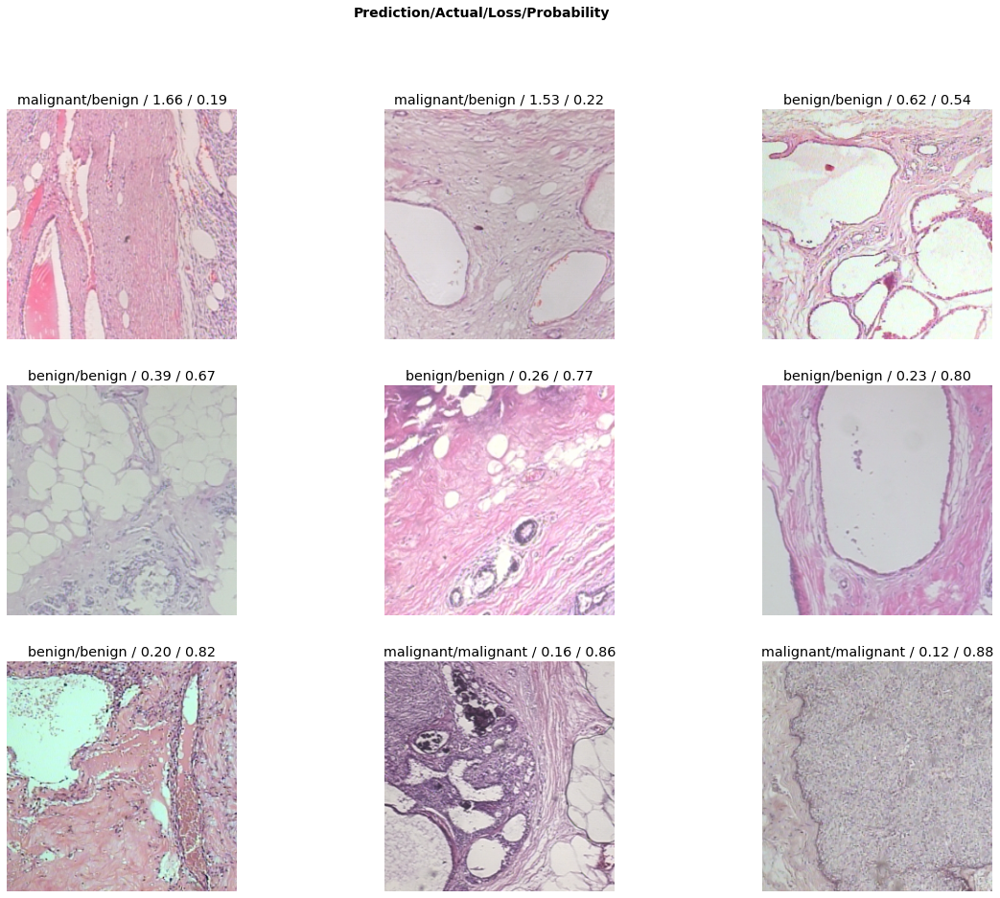

In [ ]:
interp.plot_top_losses(9, figsize=(20,15))

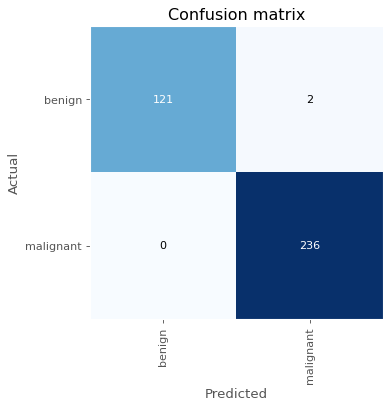

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=80)

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


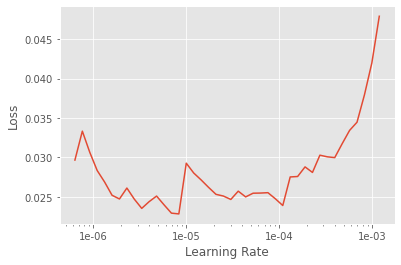

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(12,max_lr = slice(1e-6,1e-4))

epoch,train_loss,valid_loss,accuracy,error_rate,precision,recall,time
0,0.025514,0.018374,0.994429,0.005571,0.994429,0.994429,00:35
1,0.023071,0.018435,0.994429,0.005571,0.994429,0.994429,00:35
2,0.020395,0.021296,0.994429,0.005571,0.994429,0.994429,00:35
3,0.019620,0.021701,0.994429,0.005571,0.994429,0.994429,00:34
4,0.017149,0.021662,0.991643,0.008357,0.991643,0.991643,00:35
5,0.016628,0.023540,0.991643,0.008357,0.991643,0.991643,00:34
6,0.017363,0.025030,0.988858,0.011142,0.988858,0.988858,00:34
7,0.014537,0.024619,0.994429,0.005571,0.994429,0.994429,00:34
8,0.024315,0.025604,0.988858,0.011142,0.988858,0.988858,00:34
9,0.022341,0.019567,0.994429,0.005571,0.994429,0.994429,00:35


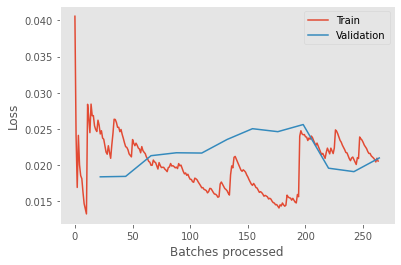

In [ ]:
learn.recorder.plot_losses()

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

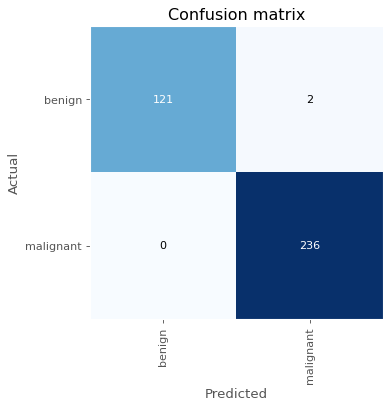

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=80)

In [ ]:
preds, y, loss = learn.get_preds(with_loss=True)
acc = accuracy(preds, y)
print('The accuracy is {0} %.'.format(acc*100))

The accuracy is 99.44290161132812 %.


In [ ]:
import sklearn.model_selection
from sklearn.metrics import roc_curve, auc

In [ ]:
# probs from log preds
probs = np.exp(preds[:,1])
# Compute ROC curve
fpr, tpr, thresholds = roc_curve(y, probs, pos_label=1)

# Compute ROC area
roc_auc = auc(fpr, tpr)
print('ROC area is {0}'.format(roc_auc))

ROC area is 0.9999311010059253


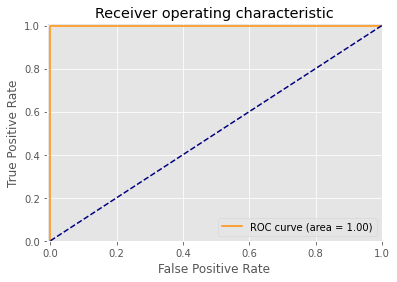

In [ ]:
plt.figure()
plt.plot(fpr, tpr, color='darkorange', label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([-0.01, 1.0])
plt.ylim([0.0, 1.01])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")

In [ ]:
preds, y, losses = learn.get_preds(DatasetType.Test, with_loss=True)
z = torch.argmax(preds, dim=1)

In [ ]:
v = []
j = []

for i in range(197):
  v.append(data.test_ds.items[i])
  j.append(z[i].cpu().numpy())

In [ ]:
import pandas as pd
a = pd.DataFrame()
a['path'] = v
a['class'] = j
A = a['path'].astype(str).str.split("/", expand = True)
a['path'] = A.iloc[:,-1]

print(a.head())

                             path class
0    SOB_B_TA-14-16184-40-021.png     0
1      SOB_B_F-14-9133-40-010.png     0
2      SOB_B_F-14-9133-40-004.png     0
3  SOB_B_PT-14-21998AB-40-003.png     0
4   SOB_B_A-14-22549CD-40-029.png     0


In [ ]:
a.to_csv('resnet50_breakhis40_resdep_bc.csv')

In [ ]:
from google.colab import files
files.download('resnet50_breakhis40_resdep_bc.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
learn.save('ResNet-50s2')

VGG-NET Architecture

In [ ]:
learn = cnn_learner(data, models.vgg19_bn, metrics=(accuracy,error_rate))

Downloading: "https://download.pytorch.org/models/vgg19_bn-c79401a0.pth" to /root/.cache/torch/hub/checkpoints/vgg19_bn-c79401a0.pth


In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


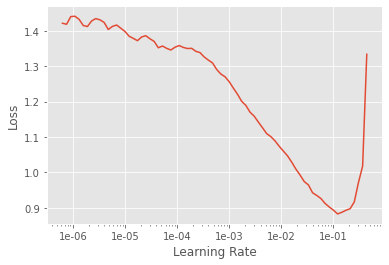

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(18)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.079474,0.496218,0.760446,0.239554,00:36
1,0.852442,0.295932,0.883008,0.116992,00:35
2,0.680271,0.273731,0.891365,0.108635,00:35
3,0.578313,0.187717,0.905292,0.094708,00:35
4,0.476790,0.234732,0.913649,0.086351,00:35
5,0.394881,0.222196,0.927577,0.072423,00:35
6,0.328754,0.183643,0.927577,0.072423,00:36
7,0.283501,0.181129,0.927577,0.072423,00:35
8,0.238209,0.164454,0.944290,0.055710,00:35
9,0.218733,0.145587,0.944290,0.055710,00:35


In [ ]:
learn.save('stage1-vgg19')

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

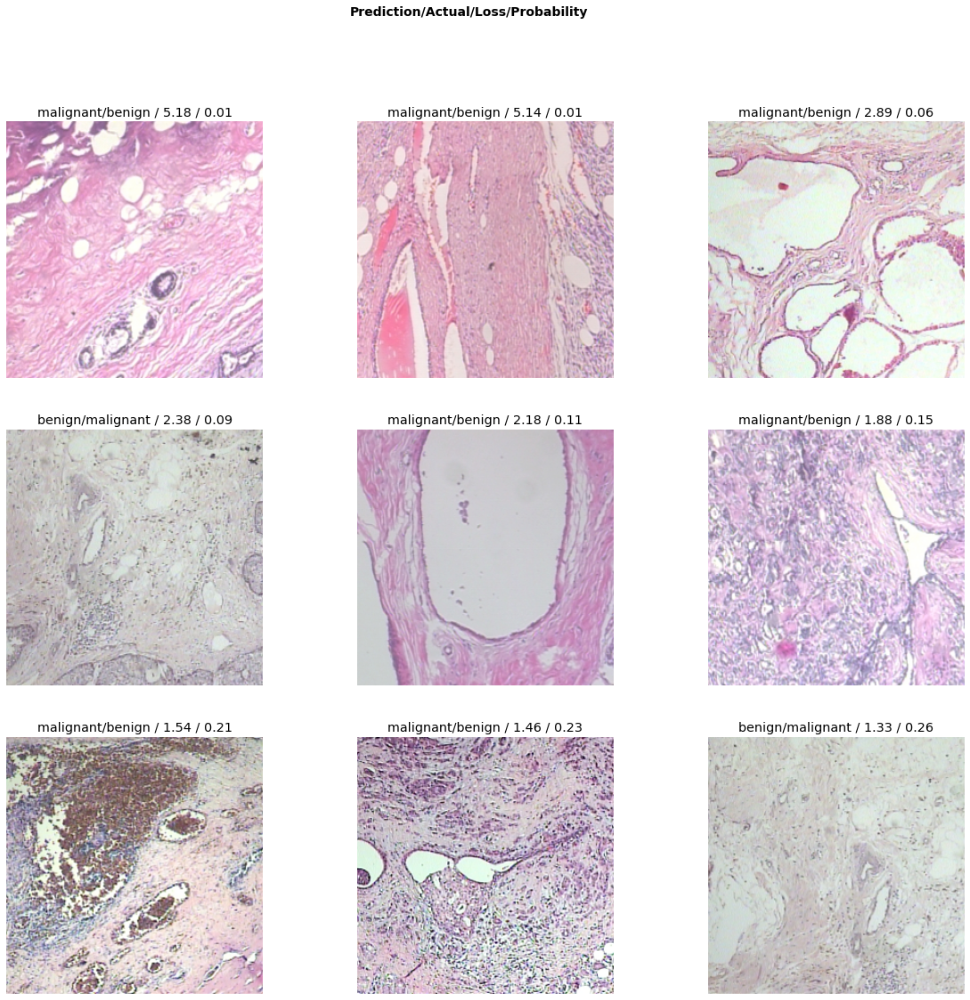

In [ ]:
interp.plot_top_losses(9, figsize=(20,18))

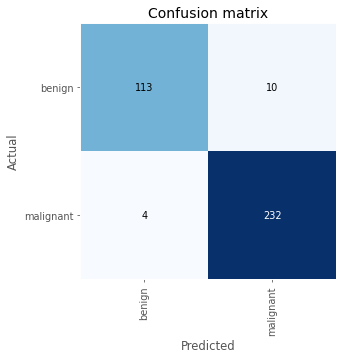

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=70)

In [ ]:
learn.unfreeze()

In [ ]:
learn.fit_one_cycle(12)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.122995,0.109588,0.958217,0.041783,00:37
1,0.153933,0.139780,0.949861,0.050139,00:37
2,0.159548,0.498677,0.902507,0.097493,00:37
3,0.174994,0.119381,0.947075,0.052925,00:37
4,0.147461,0.093991,0.966574,0.033426,00:37
5,0.138123,0.135805,0.947075,0.052925,00:37
6,0.131153,0.070850,0.972145,0.027855,00:37
7,0.103692,0.083244,0.974930,0.025070,00:37
8,0.088435,0.048646,0.988858,0.011142,00:37
9,0.073310,0.056861,0.983287,0.016713,00:37


In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

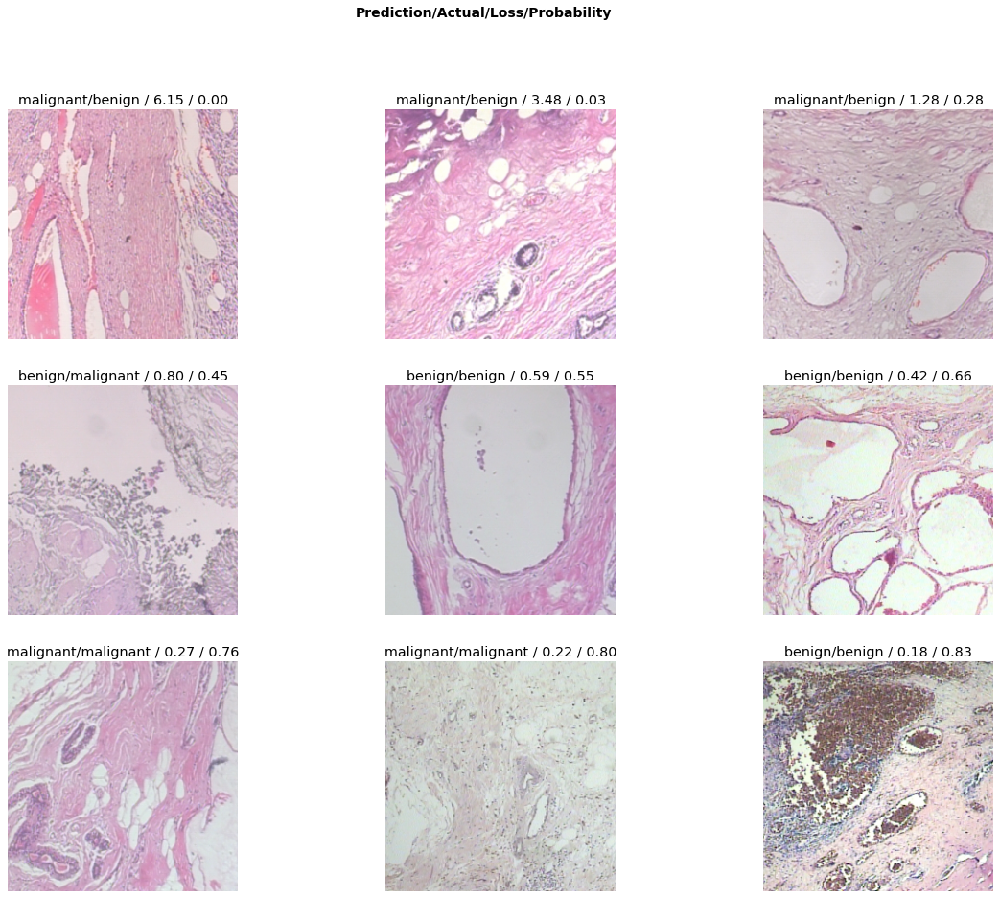

In [ ]:
interp.plot_top_losses(9, figsize=(20,15))

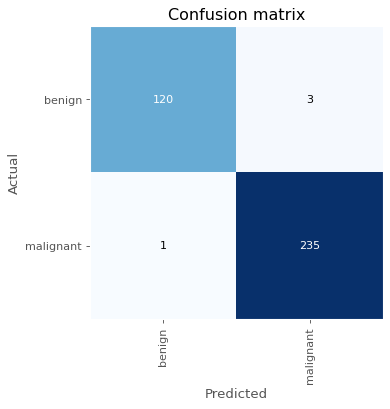

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=80)

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


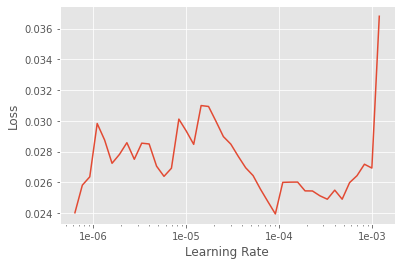

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(12,max_lr = slice(1e-05,1e-04))

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.028910,0.041851,0.988858,0.011142,00:37
1,0.028209,0.044492,0.988858,0.011142,00:37
2,0.024747,0.041349,0.988858,0.011142,00:37
3,0.021722,0.047154,0.983287,0.016713,00:38
4,0.019296,0.048612,0.980501,0.019499,00:38
5,0.024060,0.045892,0.983287,0.016713,00:37
6,0.022708,0.035645,0.988858,0.011142,00:37
7,0.020572,0.041932,0.980501,0.019499,00:37
8,0.018170,0.033512,0.988858,0.011142,00:37
9,0.015081,0.034904,0.988858,0.011142,00:37


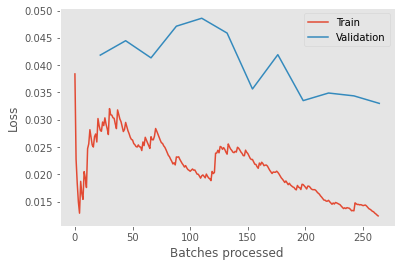

In [ ]:
learn.recorder.plot_losses()

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

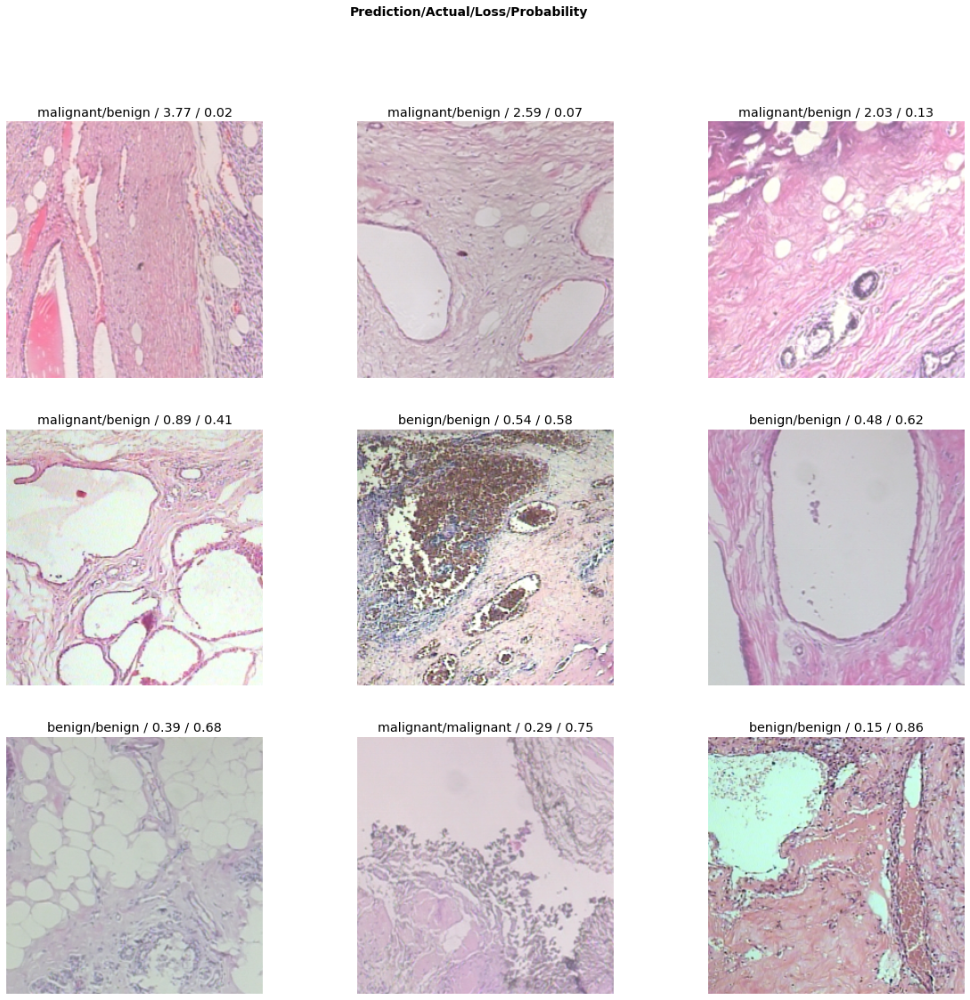

In [ ]:
interp.plot_top_losses(9, figsize=(20,18))

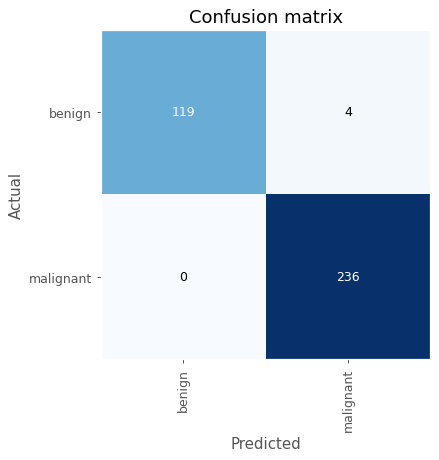

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=90)

In [ ]:
preds, y, loss = learn.get_preds(with_loss=True)
acc = accuracy(preds, y)
print('The accuracy is {0} %.'.format(acc*100))

The accuracy is 98.88579559326172 %.


In [ ]:
import sklearn.model_selection
from sklearn.metrics import roc_curve, auc

In [ ]:
# probs from log preds
probs = np.exp(preds[:,1])
# Compute ROC curve
fpr, tpr, thresholds = roc_curve(y, probs, pos_label=1)

# Compute ROC area
roc_auc = auc(fpr, tpr)
print('ROC area is {0}'.format(roc_auc))

ROC area is 0.9996555050296265


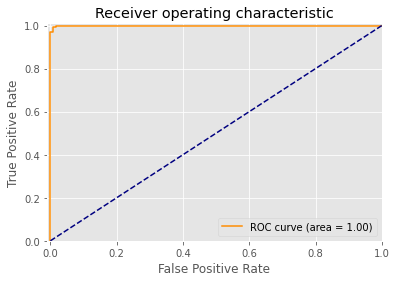

In [ ]:
plt.figure()
plt.plot(fpr, tpr, color='darkorange', label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([-0.01, 1.0])
plt.ylim([0.0, 1.01])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")

In [ ]:
preds, y, losses = learn.get_preds(DatasetType.Test, with_loss=True)
z = torch.argmax(preds, dim=1)

In [ ]:
v = []
j = []

for i in range(197):
  v.append(data.test_ds.items[i])
  j.append(z[i].cpu().numpy())

In [ ]:
import pandas as pd
a = pd.DataFrame()
a['path'] = v
a['class'] = j
A = a['path'].astype(str).str.split("/", expand = True)
a['path'] = A.iloc[:,-1]

print(a.head())

                             path class
0    SOB_B_TA-14-16184-40-021.png     0
1      SOB_B_F-14-9133-40-010.png     0
2      SOB_B_F-14-9133-40-004.png     0
3  SOB_B_PT-14-21998AB-40-003.png     0
4   SOB_B_A-14-22549CD-40-029.png     0


In [ ]:
a.to_csv('vgg19_breakhis40_res_dep_bc.csv')

In [ ]:
from google.colab import files
files.download('vgg19_breakhis40_res_dep_bc.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Inception

In [ ]:
from fastai.vision import *
from fastai.metrics import accuracy
import torch
import torchvision.models as TorchModels
import numpy as np

In [ ]:
bs= 64
sz=299 # image size for Inception-V3

In [ ]:
np.random.seed(42)
data = ImageDataBunch.from_folder(path, ds_tfms=tfms,valid_pct=0.2, test=path_test, size = sz, bs= bs). normalize (imagenet_stats)

In [ ]:
inceptionModel = TorchModels.inception_v3(pretrained=True)

Downloading: "https://download.pytorch.org/models/inception_v3_google-1a9a5a14.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-1a9a5a14.pth


In [ ]:
for param in inceptionModel.parameters():
    param.requires_grad = False

In [ ]:
num_ftrs = inceptionModel.AuxLogits.fc.in_features
inceptionModel.AuxLogits.fc = nn.Linear(num_ftrs, len(data.classes))

num_ftrs = inceptionModel.fc.in_features
inceptionModel.fc = nn.Linear(num_ftrs, len(data.classes))

In [ ]:
inceptionModel = inceptionModel.cuda()

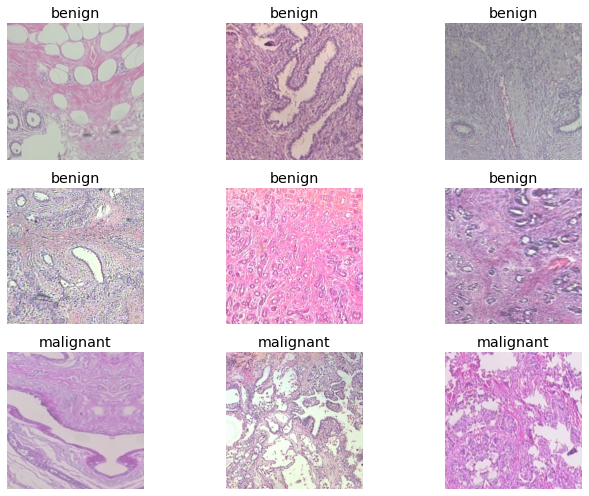

In [ ]:
data.show_batch(rows = 3, figsize = (10,7))

In [ ]:
print(data.classes)

['benign', 'malignant']


In [ ]:
def my_loss(preds,target):
 if isinstance(preds, tuple):
    loss = sum((F.cross_entropy(o,target) for o in preds))
 else:
    loss = F.cross_entropy(preds,target)
 return loss

In [ ]:
learn = Learner(data, inceptionModel, loss_func=my_loss, metrics=accuracy)

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


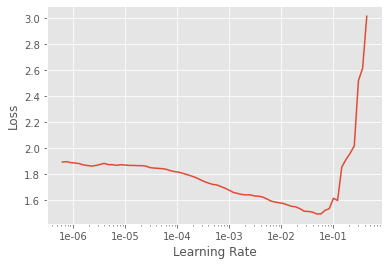

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(18)

epoch,train_loss,valid_loss,accuracy,time
0,1.419903,0.607003,0.676880,00:40
1,1.308434,0.535220,0.699164,00:40
2,1.170837,0.458360,0.813370,00:41
3,1.053382,0.410571,0.827298,00:40
4,0.976475,0.391908,0.866295,00:41
5,0.920016,0.345598,0.871866,00:40
6,0.869071,0.332464,0.877437,00:41
7,0.843252,0.325407,0.880223,00:40
8,0.805522,0.338036,0.849582,00:39
9,0.772610,0.316416,0.891365,00:39


In [ ]:
interp.plot_top_losses(k=9,heatmap=False)

NameError: ignored

In [ ]:
learn.unfreeze()

In [ ]:
learn.fit_one_cycle(12)

epoch,train_loss,valid_loss,accuracy,time
0,0.549080,0.622370,0.919220,00:40
1,0.534521,7.191374,0.810585,00:40
2,0.568197,199.405899,0.342618,00:40
3,0.664586,5.780591,0.445682,00:40
4,0.621786,0.473956,0.885794,00:40
5,0.562090,0.198806,0.924791,00:40
6,0.501215,0.183355,0.922006,00:40
7,0.432922,0.144174,0.947075,00:40
8,0.367713,0.089151,0.966574,00:40
9,0.316768,0.105389,0.958217,00:40


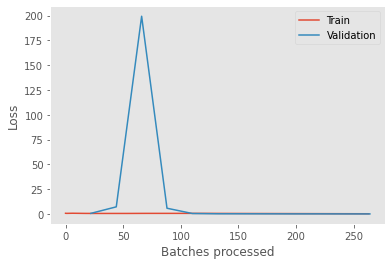

In [ ]:
learn.recorder.plot_losses()

In [ ]:
learn.save('inceptstage2')

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


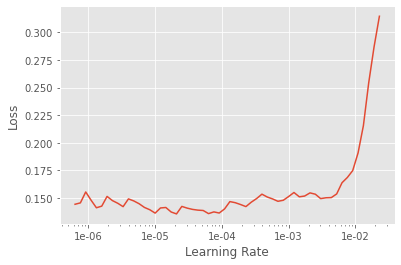

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(12,1e-4)

epoch,train_loss,valid_loss,accuracy,time
0,0.134661,0.049437,0.983287,00:40
1,0.140841,0.046067,0.983287,00:40
2,0.135629,0.048323,0.983287,00:40
3,0.139301,0.051847,0.974930,00:40
4,0.125810,0.049054,0.972145,00:40
5,0.125039,0.043081,0.980501,00:41
6,0.116424,0.032489,0.986072,00:40
7,0.120350,0.034608,0.983287,00:40
8,0.108533,0.034462,0.980501,00:40
9,0.106427,0.034713,0.980501,00:40


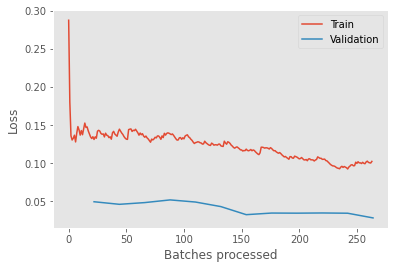

In [ ]:
learn.recorder.plot_losses()

AlexNet

In [ ]:
data = ImageDataBunch.from_folder(path, ds_tfms=tfms, valid_pct=0.2, test = path_test, size=256, bs=64).normalize(imagenet_stats)

In [ ]:
learn = cnn_learner(data, models.alexnet, metrics=(accuracy,error_rate))

Downloading: "https://download.pytorch.org/models/alexnet-owt-4df8aa71.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-4df8aa71.pth


In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


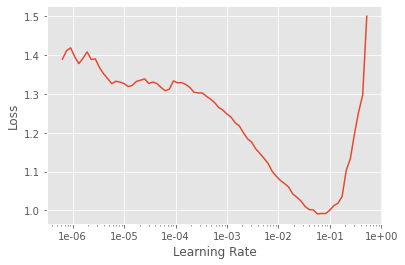

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(18)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.137305,0.570820,0.727019,0.272981,00:34
1,0.898021,0.400295,0.835655,0.164345,00:34
2,0.721141,0.309646,0.880223,0.119777,00:34
3,0.642787,0.288047,0.888579,0.111421,00:34
4,0.562863,0.272671,0.891365,0.108635,00:34
5,0.498415,0.273229,0.891365,0.108635,00:34
6,0.451251,0.271606,0.894150,0.105850,00:34
7,0.419313,0.245345,0.910864,0.089136,00:34
8,0.383611,0.218978,0.910864,0.089136,00:34
9,0.360095,0.205653,0.930362,0.069638,00:34


In [ ]:
learn.save('alex-stage1')

In [ ]:
len(data.valid_ds)

359

In [ ]:
len(losses)

NameError: ignored

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

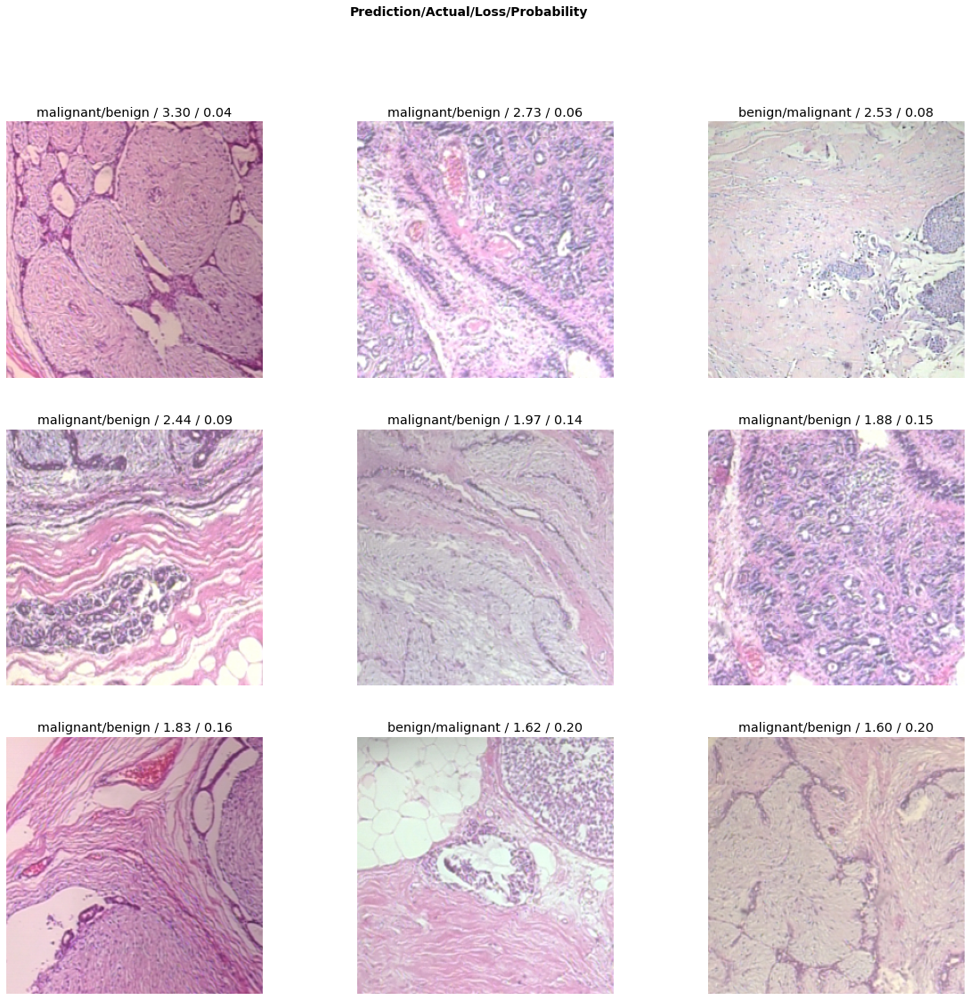

In [ ]:
interp.plot_top_losses(9, figsize=(20,18))

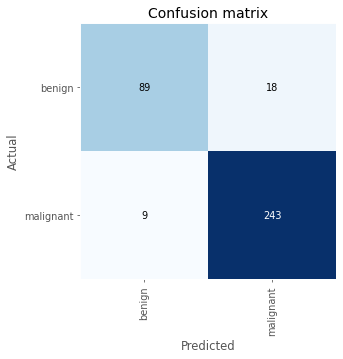

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=70)

In [ ]:
learn.unfreeze()

In [ ]:
learn.fit_one_cycle(12)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.227109,0.170144,0.927577,0.072423,00:34
1,0.221938,0.165132,0.941504,0.058496,00:34
2,0.212799,0.194946,0.927577,0.072423,00:34
3,0.227865,0.679390,0.785515,0.214485,00:34
4,0.238438,1.258355,0.637883,0.362117,00:34
5,0.248446,0.297069,0.888579,0.111421,00:34
6,0.226945,0.370506,0.838440,0.161560,00:34
7,0.202203,0.175552,0.916435,0.083565,00:34
8,0.185550,0.091689,0.963788,0.036212,00:35
9,0.162868,0.100380,0.980501,0.019499,00:34


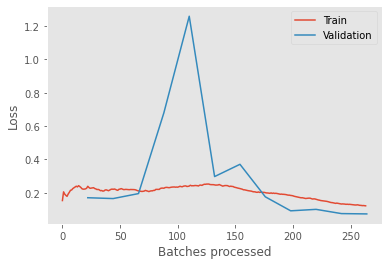

In [ ]:
learn.recorder.plot_losses()

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

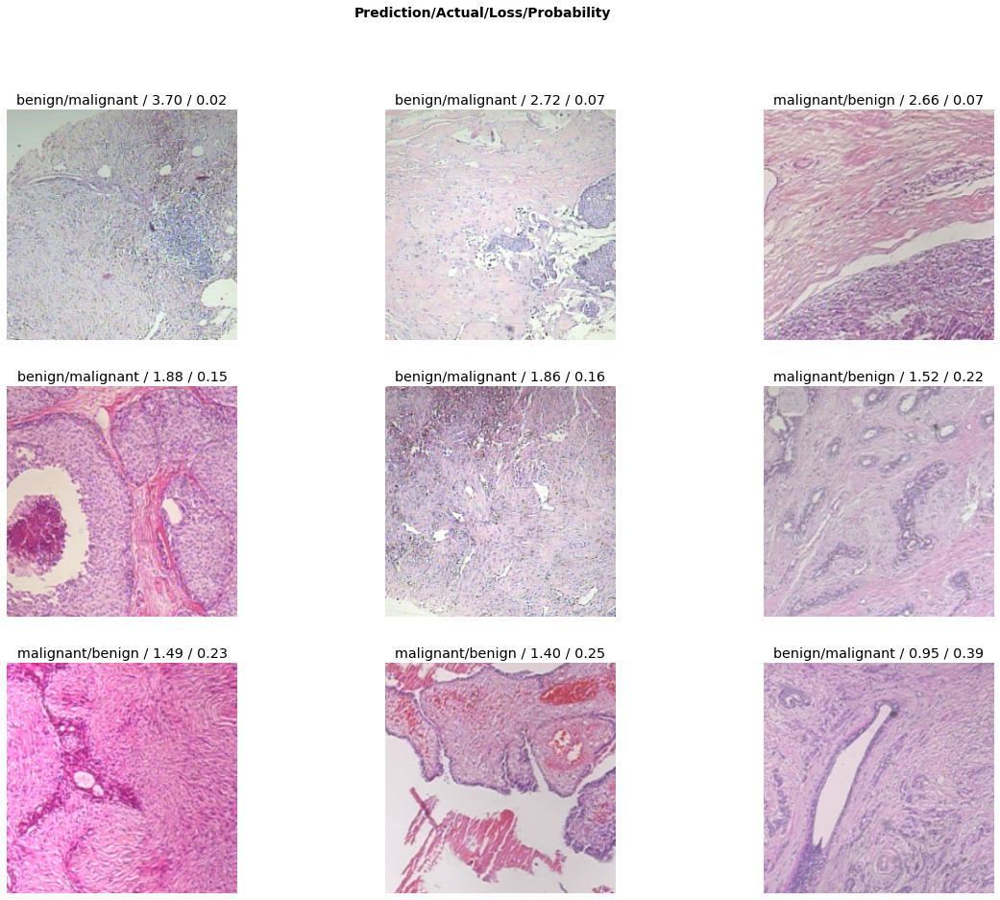

In [ ]:
interp.plot_top_losses(9, figsize=(20,15))

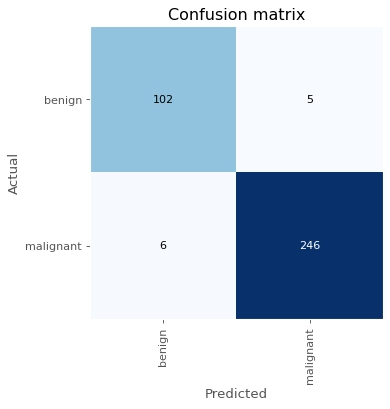

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=80)

In [ ]:
conf_matrix = interp.confusion_matrix()
conf_matrix


array([[102,   5],
       [  6, 246]])

In [ ]:
tn, fp, fn, tp = conf_matrix.item(0), conf_matrix.item(1), conf_matrix.item(2), conf_matrix.item(3)
tp, fp, fn, tn

(246, 5, 6, 102)

In [ ]:
total = tp + fp + fn + tn
accur = (tp+tn)/total
accur

0.9693593314763231

In [ ]:
learn.save('stage_2_alex')


In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


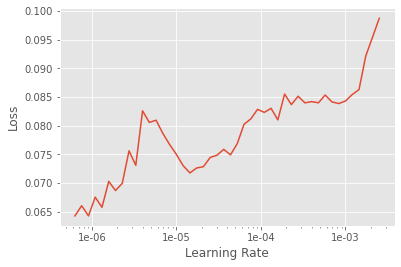

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(12,1e-06)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.076269,0.073224,0.969359,0.030641,00:34
1,0.075699,0.074022,0.969359,0.030641,00:34
2,0.079256,0.073770,0.969359,0.030641,00:34
3,0.079507,0.072722,0.972145,0.027855,00:34
4,0.078138,0.073071,0.972145,0.027855,00:34
5,0.082051,0.073199,0.972145,0.027855,00:34
6,0.083093,0.075022,0.969359,0.030641,00:34
7,0.080835,0.072949,0.972145,0.027855,00:34
8,0.081210,0.075283,0.969359,0.030641,00:34
9,0.083247,0.076033,0.969359,0.030641,00:34


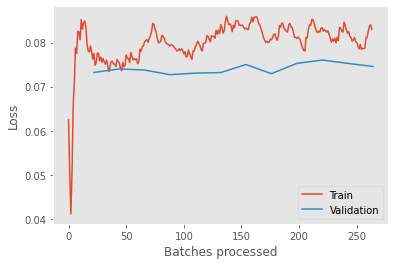

In [ ]:
learn.recorder.plot_losses()

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

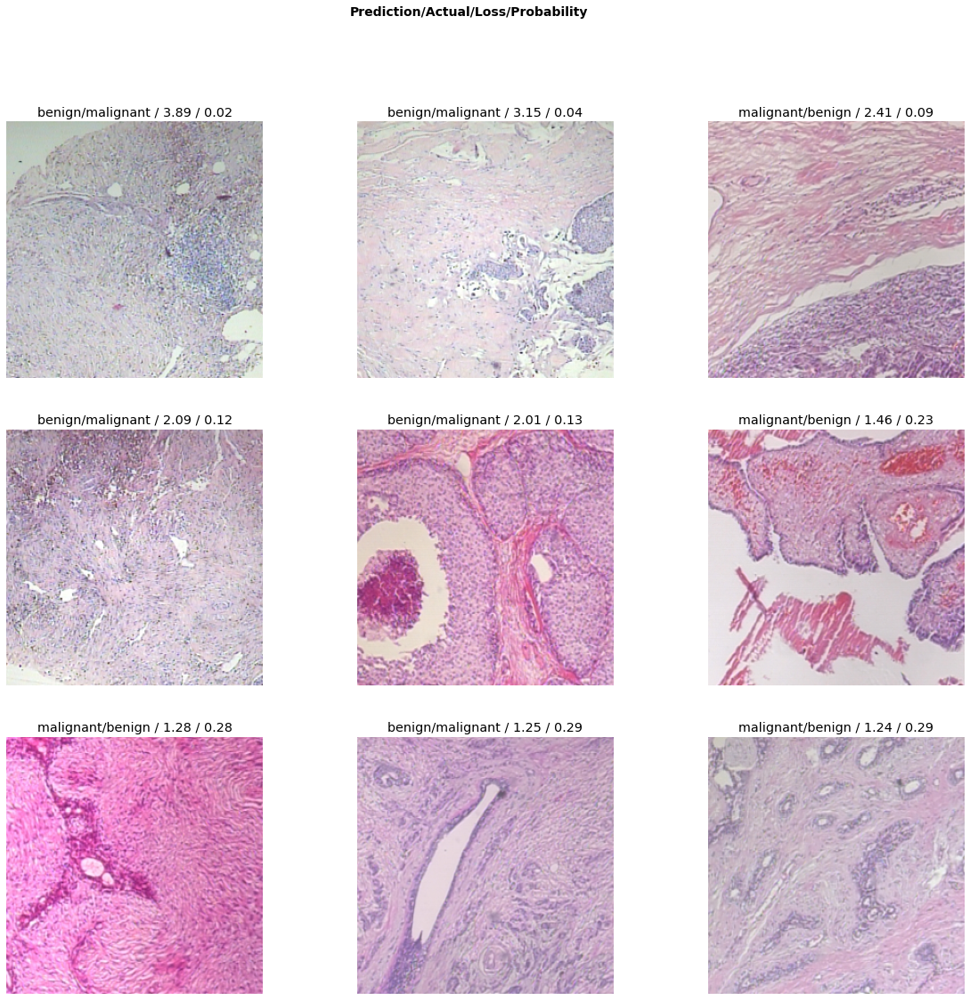

In [ ]:
interp.plot_top_losses(9, figsize=(20,18))

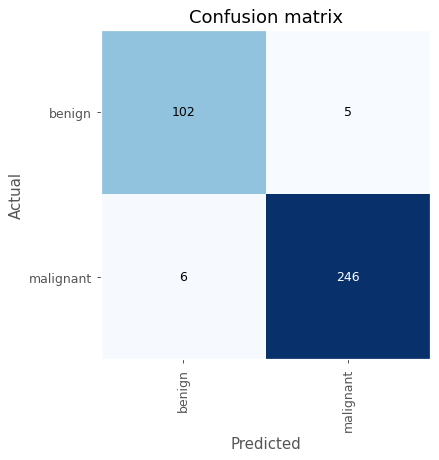

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=90)

In [ ]:
preds, y, loss = learn.get_preds(with_loss=True)
acc = accuracy(preds, y)
print('The accuracy is {0} %.'.format(acc*100))

The accuracy is 96.9359359741211 %.


In [ ]:
import sklearn.model_selection
from sklearn.metrics import roc_curve, auc

In [ ]:
# probs from log preds
probs = np.exp(preds[:,1])
# Compute ROC curve
fpr, tpr, thresholds = roc_curve(y, probs, pos_label=1)

# Compute ROC area
roc_auc = auc(fpr, tpr)
print('ROC area is {0}'.format(roc_auc))

ROC area is 0.9967363892597537


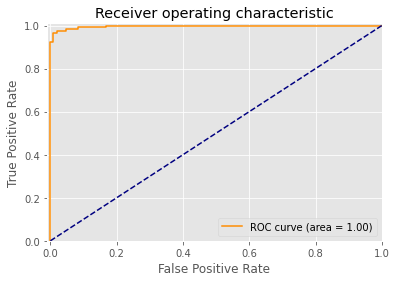

In [ ]:
plt.figure()
plt.plot(fpr, tpr, color='darkorange', label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([-0.01, 1.0])
plt.ylim([0.0, 1.01])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")

In [ ]:
preds, y, losses = learn.get_preds(DatasetType.Test, with_loss=True)
z = torch.argmax(preds, dim=1)

In [ ]:
v = []
j = []

for i in range(197):
  v.append(data.test_ds.items[i])
  j.append(z[i].cpu().numpy())

In [ ]:
import pandas as pd
a = pd.DataFrame()
a['path'] = v
a['class'] = j
A = a['path'].astype(str).str.split("/", expand = True)
a['path'] = A.iloc[:,-1]

print(a.head())

                             path class
0    SOB_B_TA-14-16184-40-021.png     0
1      SOB_B_F-14-9133-40-010.png     1
2      SOB_B_F-14-9133-40-004.png     0
3  SOB_B_PT-14-21998AB-40-003.png     1
4   SOB_B_A-14-22549CD-40-029.png     0


In [ ]:
a.to_csv('alexnet_breakhis40_res_dep_bc.csv')

In [ ]:
from google.colab import files
files.download('alexnet_breakhis40_res_dep_bc.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

DenseNet121

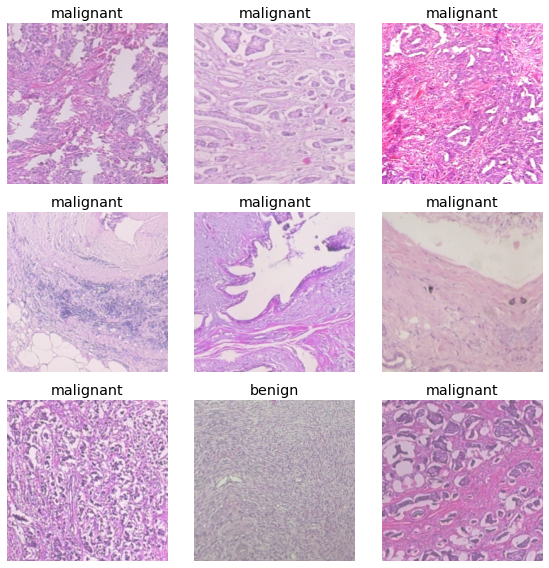

In [ ]:
data = ImageDataBunch.from_folder(path, ds_tfms=tfms, valid_pct=0.2,size=256, bs=64).normalize(imagenet_stats)
data.show_batch(rows=3, figsize=(8,8))

In [ ]:
learn = cnn_learner(data, models.densenet121, metrics=(accuracy, error_rate, Precision(average='micro'), Recall(average='micro') ))

Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth


In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


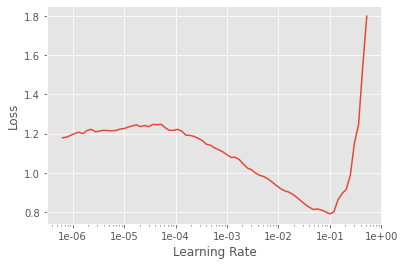

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(18)

epoch,train_loss,valid_loss,accuracy,error_rate,precision,recall,time
0,0.915564,0.386392,0.816156,0.183844,0.816156,0.816156,00:38
1,0.711149,0.289188,0.869081,0.130919,0.869081,0.869081,00:37
2,0.541601,0.250662,0.905292,0.094708,0.905293,0.905292,00:37
3,0.430717,0.181847,0.930362,0.069638,0.930362,0.930362,00:37
4,0.360937,0.183835,0.938719,0.061281,0.938719,0.938719,00:37
5,0.304922,0.134137,0.955432,0.044568,0.955432,0.955432,00:37
6,0.262711,0.155345,0.947075,0.052925,0.947075,0.947075,00:37
7,0.225059,0.157290,0.961003,0.038997,0.961003,0.961003,00:36
8,0.194161,0.092413,0.966574,0.033426,0.966574,0.966574,00:37
9,0.162765,0.113475,0.966574,0.033426,0.966574,0.966574,00:37


In [ ]:
learn.save('stage1-denseNet')

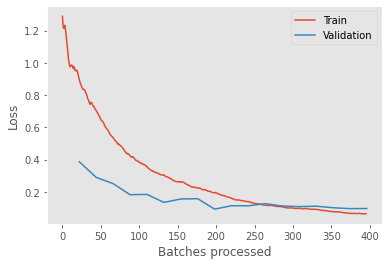

In [ ]:
learn.recorder.plot_losses()

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

In [ ]:
losses
idxs

tensor([ 13,   0,  80, 119, 328, 122, 290, 219, 326, 255, 247, 243, 204, 183,
         47, 218, 261,  57, 159, 181, 330, 106, 299,   4, 190, 311,  81, 150,
        294,  24, 135, 158, 137, 144,  87,  84, 242, 180, 117, 358, 249,  39,
        100,  58,  91,  11, 153, 332, 103, 107, 337, 147,  64, 105, 163, 275,
         21, 213, 140, 120, 160,  85, 185, 170, 245,  70, 352, 256, 274, 195,
         69,  62,  37, 202, 291,  79, 233, 319, 143,  99, 279,  50,   2, 338,
         28,  71, 157, 313, 201,  77, 258, 191, 197, 189,  20, 234,   7, 302,
        340, 186, 342, 316,  60,  95,  16, 262, 236, 232, 229, 259, 235, 310,
        172, 318, 240, 295, 110, 194, 136, 226, 128, 139, 123, 212, 278, 108,
        317,  42, 154,  67, 356, 305,  45, 339, 133, 341, 155, 200, 283, 344,
         82, 199, 323,  46, 225,  33, 292, 246,  34, 148, 289, 312, 151,  68,
         66,  23,  40, 132,  74, 228, 306, 227,   8, 331, 300, 281,  43, 265,
        131,  90, 248,  61, 167, 187, 164, 192, 335, 215, 220, 1

In [ ]:
len(data.valid_ds)

359

In [ ]:
len(losses)

359

In [ ]:
len(idxs)

359

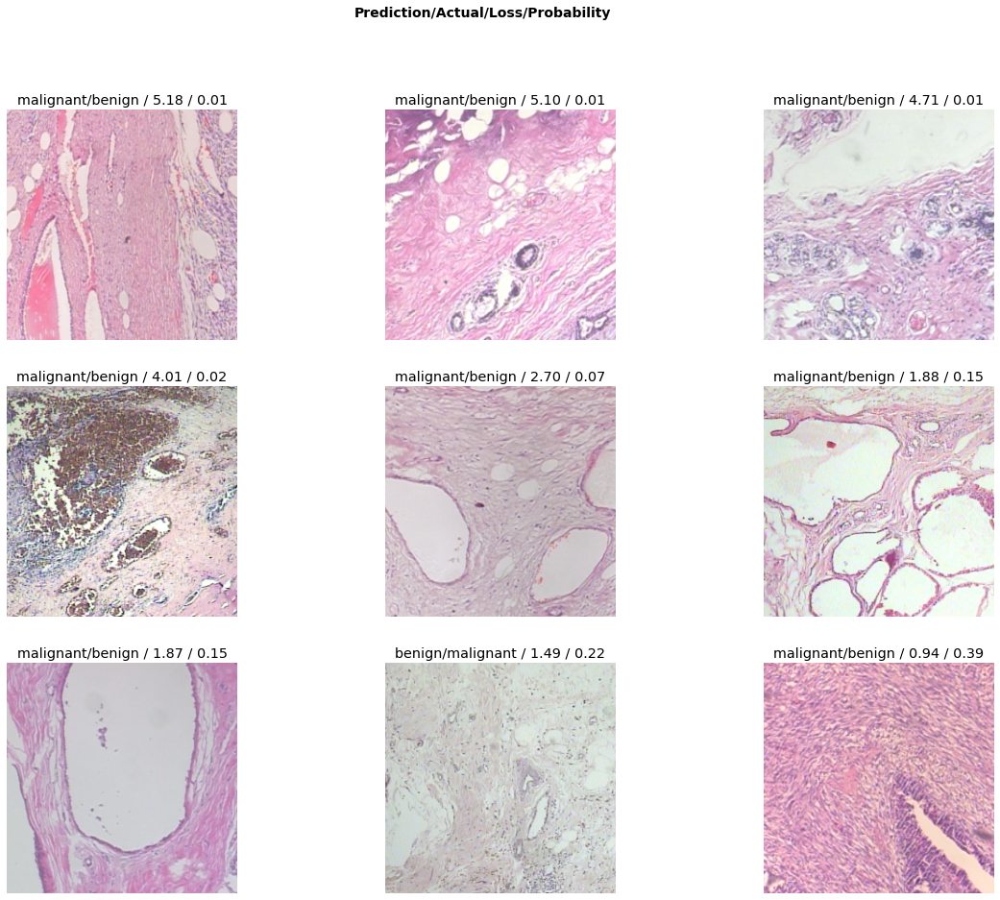

In [ ]:
interp.plot_top_losses(9, figsize=(20,15))

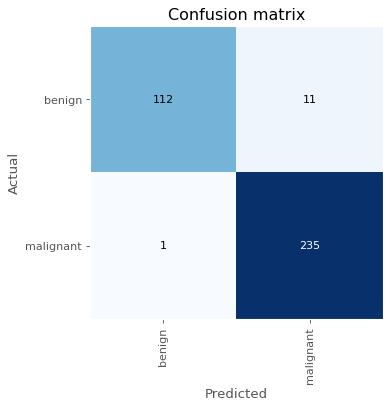

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=80)

In [ ]:
learn.unfreeze()

In [ ]:
learn.fit_one_cycle(12)

epoch,train_loss,valid_loss,accuracy,error_rate,precision,recall,time
0,0.061985,0.096132,0.972145,0.027855,0.972145,0.972145,00:38
1,0.079901,0.112450,0.961003,0.038997,0.961003,0.961003,00:37
2,0.109987,0.264356,0.930362,0.069638,0.930362,0.930362,00:37
3,0.136296,0.451857,0.885794,0.114206,0.885794,0.885794,00:38
4,0.138290,0.070145,0.983287,0.016713,0.983287,0.983287,00:38
5,0.117075,0.053240,0.983287,0.016713,0.983287,0.983287,00:38
6,0.095047,0.150723,0.969359,0.030641,0.969359,0.969359,00:37
7,0.081885,0.155658,0.947075,0.052925,0.947075,0.947075,00:38
8,0.066311,0.060251,0.974930,0.025070,0.974930,0.974930,00:38
9,0.050364,0.036143,0.991643,0.008357,0.991643,0.991643,00:37


In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


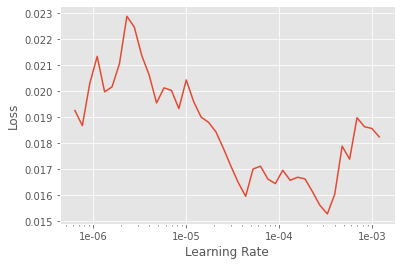

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(12,max_lr=slice(1e-04))

epoch,train_loss,valid_loss,accuracy,error_rate,precision,recall,time
0,0.026004,0.033737,0.988858,0.011142,0.988858,0.988858,00:37
1,0.022740,0.031615,0.988858,0.011142,0.988858,0.988858,00:37
2,0.022268,0.030411,0.988858,0.011142,0.988858,0.988858,00:37
3,0.021747,0.029039,0.991643,0.008357,0.991643,0.991643,00:37
4,0.020946,0.025274,0.991643,0.008357,0.991643,0.991643,00:37
5,0.020515,0.027841,0.988858,0.011142,0.988858,0.988858,00:37
6,0.019818,0.025923,0.988858,0.011142,0.988858,0.988858,00:37
7,0.021644,0.025872,0.988858,0.011142,0.988858,0.988858,00:37
8,0.017467,0.031050,0.988858,0.011142,0.988858,0.988858,00:37
9,0.016806,0.030356,0.988858,0.011142,0.988858,0.988858,00:37


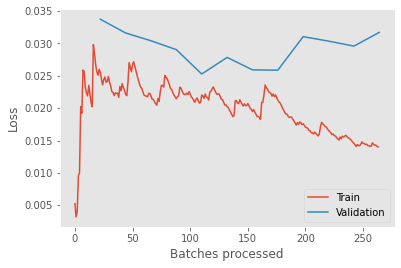

In [ ]:
learn.recorder.plot_losses()

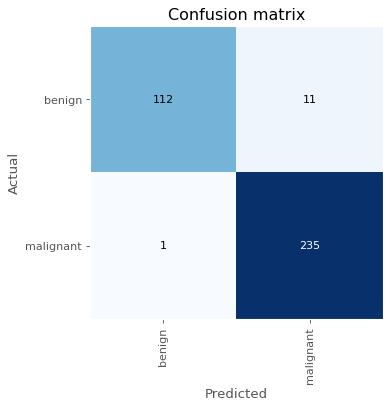

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=80)

In [ ]:
conf_matrix = interp.confusion_matrix()
conf_matrix

array([[112,  11],
       [  1, 235]])

In [ ]:
tn, fp, fn, tp = conf_matrix.item(0), conf_matrix.item(1), conf_matrix.item(2), conf_matrix.item(3)
tp, fp, fn, tn

(235, 11, 1, 112)

In [ ]:
total = tp + fp + fn + tn
accur = (tp+tn)/total
accur

0.9665738161559888

In [ ]:
learn.save('stage2-densenet')

In [ ]:
preds, y, loss = learn.get_preds(with_loss=True)
acc = accuracy(preds, y)
print('The accuracy is {0} %.'.format(acc*100))

The accuracy is 98.88579559326172 %.


In [ ]:
import sklearn.model_selection
from sklearn.metrics import roc_curve, auc

In [ ]:
# probs from log preds
probs = np.exp(preds[:,1])
# Compute ROC curve
fpr, tpr, thresholds = roc_curve(y, probs, pos_label=1)

# Compute ROC area
roc_auc = auc(fpr, tpr)
print('ROC area is {0}'.format(roc_auc))

ROC area is 0.9994488080474025


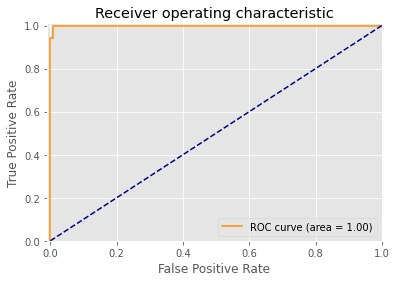

In [ ]:
plt.figure()
plt.plot(fpr, tpr, color='darkorange', label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([-0.01, 1.0])
plt.ylim([0.0, 1.01])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")

In [ ]:
preds, y, losses = learn.get_preds(DatasetType.Test, with_loss=True)
z = torch.argmax(preds, dim=1)

AttributeError: ignored

In [ ]:
v = []
j = []

for i in range(197):
  v.append(data.test_ds.items[i])
  j.append(z[i].cpu().numpy())

In [ ]:
import pandas as pd
a = pd.DataFrame()
a['path'] = v
a['class'] = j
A = a['path'].astype(str).str.split("/", expand = True)
a['path'] = A.iloc[:,-1]

print(a.head())

                             path class
0    SOB_B_TA-14-16184-40-021.png     0
1      SOB_B_F-14-9133-40-010.png     0
2      SOB_B_F-14-9133-40-004.png     0
3  SOB_B_PT-14-21998AB-40-003.png     0
4   SOB_B_A-14-22549CD-40-029.png     0


In [ ]:
a.to_csv('densenet_breakhis40_res_dep_bc.csv')

In [ ]:
from google.colab import files
files.download('densenet_breakhis40_res_dep_bc.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

ResNet

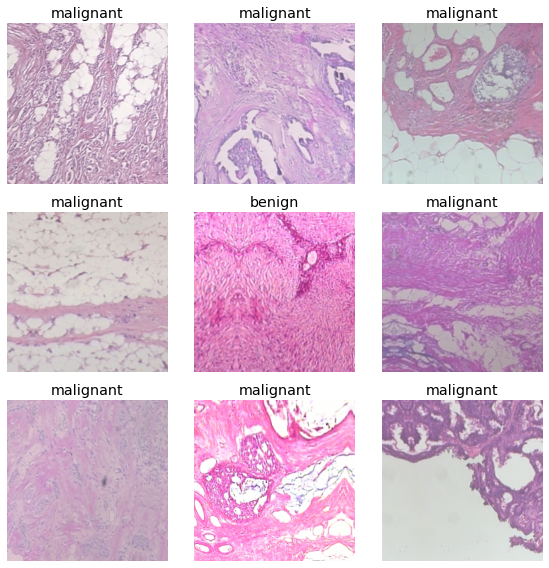

In [ ]:
data = ImageDataBunch.from_folder(path, ds_tfms=tfms, valid_pct=0.2, test=path_test , size=256, bs=64).normalize(imagenet_stats)
data.show_batch(rows=3, figsize=(8,8))

In [ ]:
learn = cnn_learner(data, models.resnet101, metrics=(accuracy, error_rate))

Downloading: "https://download.pytorch.org/models/resnet101-5d3b4d8f.pth" to /root/.cache/torch/hub/checkpoints/resnet101-5d3b4d8f.pth


In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


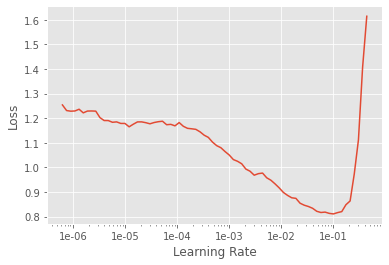

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(12)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.854213,0.312057,0.899721,0.100279,00:38
1,0.658558,0.296941,0.905292,0.094708,00:38
2,0.523798,0.177830,0.930362,0.069638,00:38
3,0.408031,0.122594,0.961003,0.038997,00:38
4,0.316961,0.104944,0.961003,0.038997,00:38
5,0.267883,0.149308,0.958217,0.041783,00:38
6,0.231436,0.107739,0.966574,0.033426,00:38
7,0.184690,0.063657,0.969359,0.030641,00:37
8,0.152767,0.054709,0.974930,0.025070,00:37
9,0.126792,0.046109,0.980501,0.019499,00:38


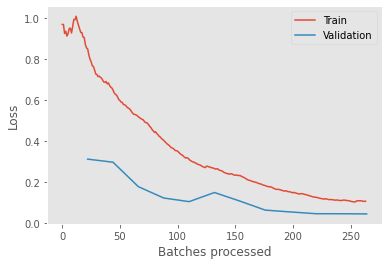

In [ ]:
learn.recorder.plot_losses()

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

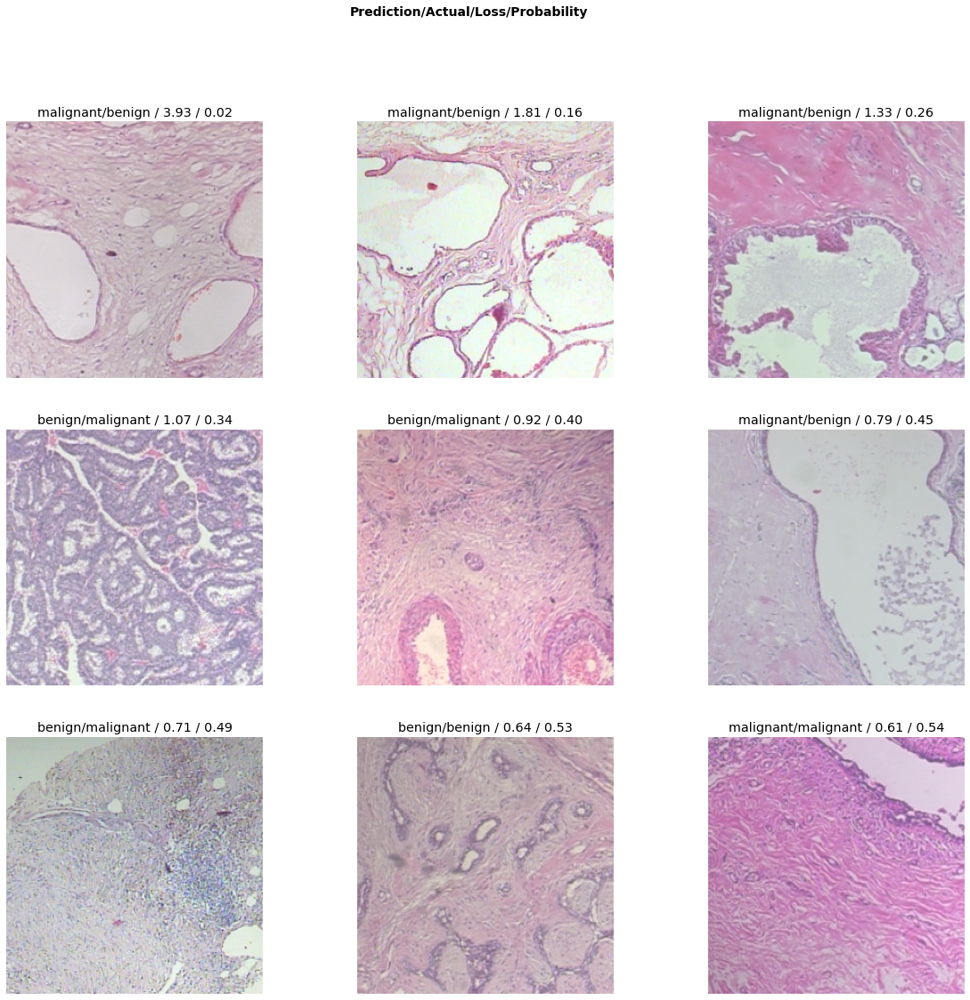

In [ ]:
interp.plot_top_losses(9, figsize=(20,18))

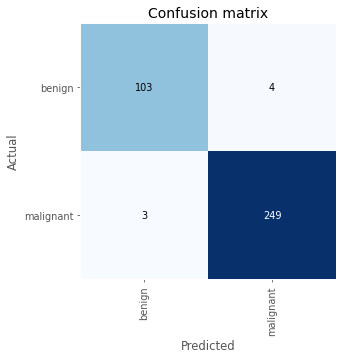

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=70)

In [ ]:
learn.save('stage-1-resnet150')

In [ ]:
learn.unfreeze()

In [ ]:
learn.fit_one_cycle(12)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.118361,0.064577,0.980501,0.019499,00:39
1,0.124214,0.187969,0.963788,0.036212,00:39
2,0.201750,0.616137,0.866295,0.133705,00:39
3,0.215035,0.277516,0.935933,0.064067,00:39
4,0.185861,0.091334,0.977716,0.022284,00:39
5,0.147763,0.024193,0.988858,0.011142,00:39
6,0.123194,0.084049,0.969359,0.030641,00:39
7,0.100178,0.019517,0.994429,0.005571,00:39
8,0.077171,0.025638,0.991643,0.008357,00:39
9,0.062037,0.029180,0.988858,0.011142,00:39


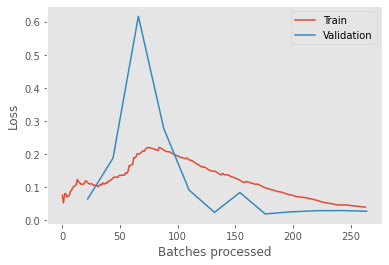

In [ ]:
learn.recorder.plot_losses()

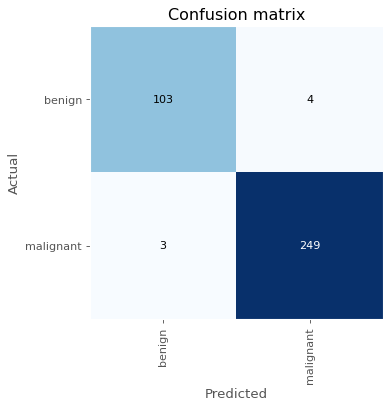

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=80)

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


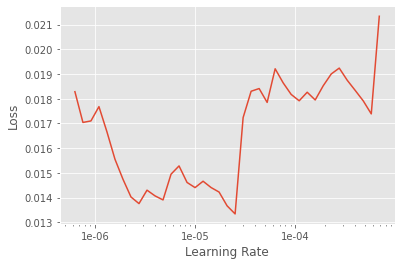

In [ ]:
learn.recorder.plot()

In [ ]:
learn.fit_one_cycle(16,max_lr=slice(5e-05,8e-04))

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.032364,0.025376,0.988858,0.011142,00:39
1,0.028354,0.013686,0.994429,0.005571,00:39
2,0.024807,0.032584,0.986072,0.013928,00:39
3,0.033591,0.032941,0.991643,0.008357,00:39
4,0.059080,0.193701,0.935933,0.064067,00:39
5,0.061021,0.040889,0.988858,0.011142,00:39
6,0.065811,0.049123,0.983287,0.016713,00:39
7,0.061914,0.056797,0.977716,0.022284,00:39
8,0.050226,0.029430,0.988858,0.011142,00:39
9,0.040237,0.033445,0.991643,0.008357,00:39


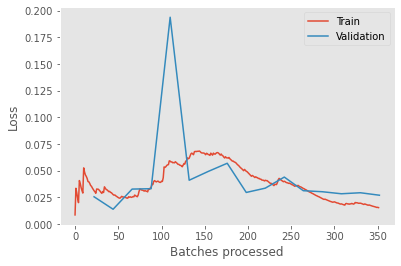

In [ ]:
learn.recorder.plot_losses()

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

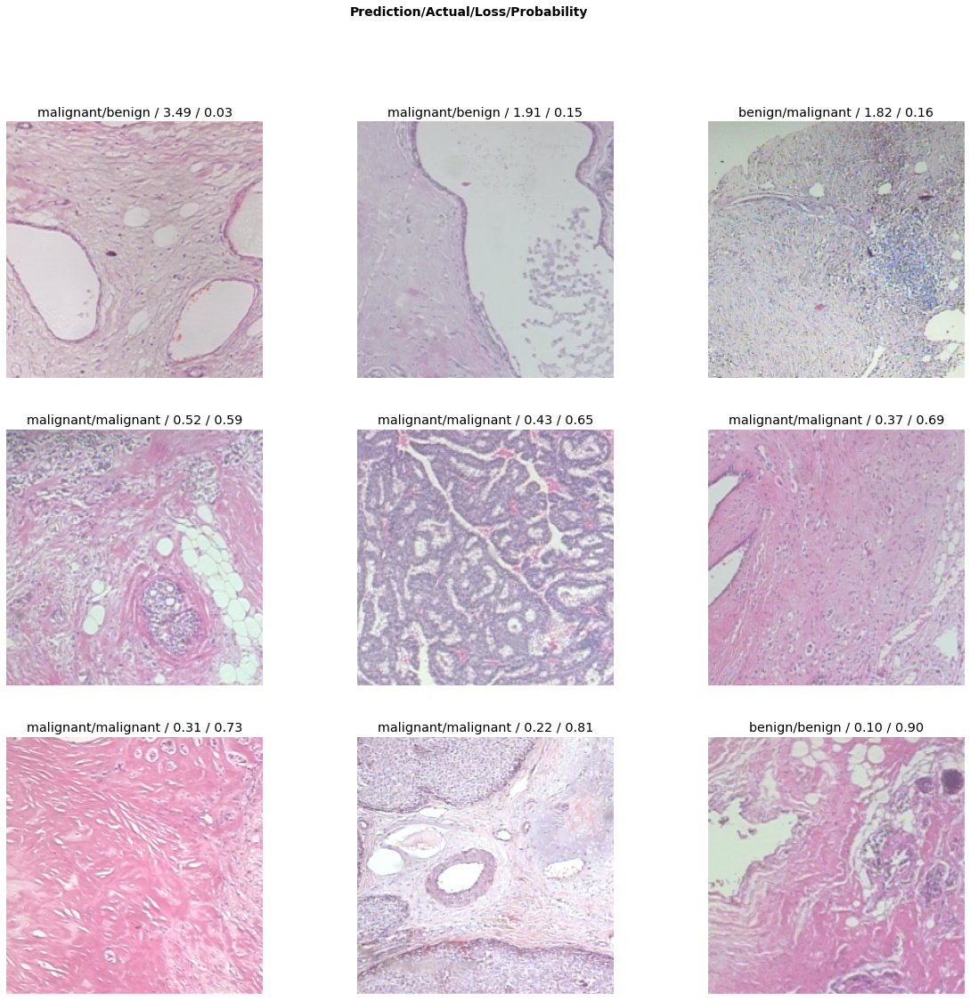

In [ ]:
interp.plot_top_losses(9, figsize=(20,18))

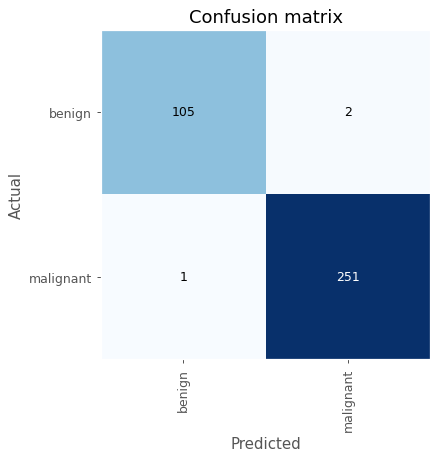

In [ ]:
interp.plot_confusion_matrix(figsize=(5,5), dpi=90)

In [ ]:
preds, y, loss = learn.get_preds(with_loss=True)
acc = accuracy(preds, y)
print('The accuracy is {0} %.'.format(acc*100))

The accuracy is 99.16434478759766 %.


In [ ]:
import sklearn.model_selection
from sklearn.metrics import roc_curve, auc

In [ ]:
# probs from log preds
probs = np.exp(preds[:,1])
# Compute ROC curve
fpr, tpr, thresholds = roc_curve(y, probs, pos_label=1)

# Compute ROC area
roc_auc = auc(fpr, tpr)
print('ROC area is {0}'.format(roc_auc))

ROC area is 0.9995178756861


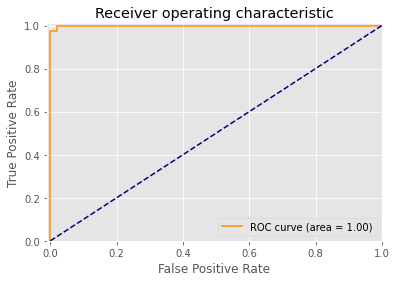

In [ ]:
plt.figure()
plt.plot(fpr, tpr, color='darkorange', label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([-0.01, 1.0])
plt.ylim([0.0, 1.01])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")

In [ ]:
preds, y, losses = learn.get_preds(DatasetType.Test, with_loss=True)
z = torch.argmax(preds, dim=1)

In [ ]:
v = []
j = []

for i in range(197):
  v.append(data.test_ds.items[i])
  j.append(z[i].cpu().numpy())

In [ ]:
import pandas as pd
a = pd.DataFrame()
a['path'] = v
a['class'] = j
A = a['path'].astype(str).str.split("/", expand = True)
a['path'] = A.iloc[:,-1]

print(a.head())

                             path class
0    SOB_B_TA-14-16184-40-021.png     0
1      SOB_B_F-14-9133-40-010.png     0
2      SOB_B_F-14-9133-40-004.png     0
3  SOB_B_PT-14-21998AB-40-003.png     0
4   SOB_B_A-14-22549CD-40-029.png     0


In [ ]:
a.to_csv('resnet101_breakhis40_res_dep_bc.csv')

In [ ]:
from google.colab import files
files.download('resnet101_breakhis40_res_dep_bc.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>